<a href="https://colab.research.google.com/github/raihanfathulb/Simple-Geospatial/blob/main/Provincial_boundaries_in_Indonesia_in_2019.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#Import Library

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import geopandas as gpd
!pip install geoplot
import geoplot as gplt
import geoplot.crs as gcrs


In [ ]:
#Connecting drive
from google.colab import drive
drive.mount('/content/drive')
%cd /content/drive/MyDrive/geospatial

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
/content/drive/MyDrive/geospatial


In [ ]:
#Read Data
jb = gpd.read_file("BATAS_PROVINSI_DESEMBER_2019_DUKCAPIL.shp")
jb.head()

,OBJECTID,PROVINSI,Shape_Leng,Shape_Area,geometry
0,1,ACEH,27.455786,4.625436,"MULTIPOLYGON Z (((97.39178 2.03748 0.00003, 97..."
1,2,BALI,6.026646,0.458717,"MULTIPOLYGON Z (((115.12509 -8.84761 0.00003, ..."
2,3,BANTEN,9.282228,0.764911,"MULTIPOLYGON Z (((105.54977 -6.99566 0.00003, ..."
3,4,BENGKULU,11.706367,1.630129,"MULTIPOLYGON Z (((102.38616 -5.47144 0.00003, ..."
4,5,DAERAH ISTIMEWA YOGYAKARTA,3.342892,0.260130,"MULTIPOLYGON Z (((110.81980 -8.20358 0.00003, ..."


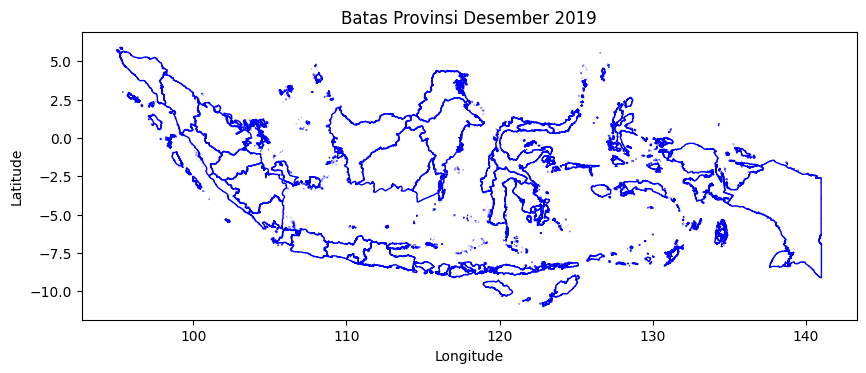

In [ ]:
plt.figure(figsize=(10, 8))
jb.plot(ax=plt.gca(), edgecolor='blue', facecolor='none')
plt.title('Batas Provinsi Desember 2019')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.show()

In [ ]:
sp = pd.read_csv("Data Stroke.csv")
sp.head()

,Provinsi,2015,2016
0,ACEH,29.82,28.16
1,SUMATERA UTARA,29.15,27.88
2,SUMATERA BARAT,32.41,30.59
3,RIAU,31.21,29.61
4,JAMBI,30.82,29.18


In [ ]:
merge = jb.merge(sp, left_on='PROVINSI', right_on='Provinsi')
merge.head()

,OBJECTID,PROVINSI,Shape_Leng,Shape_Area,geometry,Provinsi,2015,2016
0,1,ACEH,27.455786,4.625436,"MULTIPOLYGON Z (((97.39178 2.03748 0.00003, 97...",ACEH,29.82,28.16
1,2,BALI,6.026646,0.458717,"MULTIPOLYGON Z (((115.12509 -8.84761 0.00003, ...",BALI,22.96,21.62
2,3,BANTEN,9.282228,0.764911,"MULTIPOLYGON Z (((105.54977 -6.99566 0.00003, ...",BANTEN,32.95,31.64
3,4,BENGKULU,11.706367,1.630129,"MULTIPOLYGON Z (((102.38616 -5.47144 0.00003, ...",BENGKULU,33.68,33.15
4,6,DKI JAKARTA,3.123689,0.053426,"MULTIPOLYGON Z (((106.87677 -6.10030 0.00003, ...",DKI JAKARTA,27.31,26.42


In [ ]:
ax = gplt.polyplot(merge, projection=gcrs.AlbersEqualArea())
plot1 = gplt.choropleth(merge,hue="2016",cmap="YlOrRd",legend=True,scheme="FisherJenks",ax=ax, figsize=(15, 10))